In [0]:
import pandas as pd
import numpy as np
import seaborn as sns
from pyspark.sql import functions as f
import matplotlib.pyplot as plt

In [0]:
%matplotlib inline

plt.style.use( 'ggplot')
plt.rcParams['figure.figsize'] = [24, 9]
plt.rcParams['font.size'] = 24

In [0]:
def describe_num(num_attributes):
    a = num_attributes.describe().T.reset_index()
    
    d4 = pd.DataFrame(num_attributes.apply( lambda x: x.max() - x.min())).T
    d5 = pd.DataFrame(num_attributes.apply( lambda x: x.skew())).T      
    d6 = pd.DataFrame(num_attributes.apply( lambda x: x.kurtosis())).T
    d7 = pd.DataFrame(num_attributes.apply( lambda x: x.unique().shape[0])).T
    
    n = pd.concat([d4, d5, d6, d7], axis=0).T.reset_index()
    n.columns = ['attibutes', 'range', 'skew', 'kurtosis', 'unique']
    b = a.merge(n, right_on='attibutes', left_on='index')
    b.drop('index', axis=1, inplace=True)
    columns = ['attibutes', 'count', 'mean', 'std', '25%', '50%', '75%', 'min', 'max', 'range',
           'skew', 'kurtosis', 'unique']
    return b[columns]

def ml_scores(model_name, y_true, y_pred):
    
    accuracy = accuracy_score(y_true, y_pred)
    accuracy_bal = balanced_accuracy_score(y_true, y_pred)
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred)
    kappa = cohen_kappa_score(y_true, y_pred)
    
    return pd.DataFrame({'Accuracy': np.round(accuracy, 3), 
                         'Balanced Accuracy': np.round(accuracy_bal, 3), 
                         'Precision': np.round(precision, 3), 
                         'Recall': np.round(recall, 3),
                         'F1': np.round(f1, 3),
                         'Kappa': np.round(kappa, 3)}, 
                        index=[model_name])

pd.options.display.float_format = '{:.4f}'.format

def cross_validation_class(model, k, data, Verbose = True, mevo=False):
    kfold = StratifiedKFold(n_splits=k, shuffle=True, random_state=28)
    accuracy_list = []
    accuracy_bal_list = []    
    precision_list = []
    recall_list = []
    f1_list = []
    kappa_list = []

    i=1
    data = data.drop("idprescricao", axis=1)
    if mevo==True:
        score_ = data["pred"].copy()
        data = data.drop(["pred"], axis=1)
    x_ = data.drop('convertida', axis=1).copy()
    y_ = data['convertida'].copy()

    for train_cv, val_cv in kfold.split(x_, y_):        
        if Verbose == True:      
            print(f'Fold Number {i}/{k}')
        else:
            pass      
        x_train_fold = x_.iloc[train_cv]
        y_train_fold = y_.iloc[train_cv]
        x_val_fold = x_.iloc[val_cv]
        y_val_fold = y_.iloc[val_cv]
        
        if mevo==False:
            model_fit = model.fit(x_train_fold, y_train_fold)
            yhat = model_fit.predict_proba(x_val_fold)
            yhat_1 = model_fit.predict(x_val_fold)
        else:
            yhat_1 = score_.iloc[val_cv]
        
        accuracy = accuracy_score(y_val_fold, yhat_1)
        accuracy_list.append(accuracy)
        
        accuracy_bal = balanced_accuracy_score(y_val_fold, yhat_1)
        accuracy_bal_list.append(accuracy_bal)
        
        precision = precision_score(y_val_fold, yhat_1, zero_division=0)
        precision_list.append(precision)
        
        recall = recall_score(y_val_fold, yhat_1, zero_division=0)
        recall_list.append(recall)
        
        f1 = f1_score(y_val_fold, yhat_1)
        f1_list.append(f1)
        
        kappa = cohen_kappa_score(y_val_fold, yhat_1)
        kappa_list.append(kappa)

        i+=1
        
    df = pd.DataFrame({'Model Name': type(model).__name__, 
                       'Accuracy': '{} +/ - {}'.format(np.mean(accuracy_list).round(4), np.std(accuracy_list).round(4)),
                       'Balanced Accuracy': '{} +/ - {}'.format( np.mean(accuracy_bal_list).round(4), np.std(accuracy_bal_list).round(4)),
                       'Precision': '{} +/ - {}'.format(np.mean(precision_list).round(4), np.std(precision_list).round(4)),
                       'Recall': '{} +/ - {}'.format(np.mean(recall_list).round(4), np.std(recall_list).round(4)),
                       'F1': '{} +/ - {}'.format(np.mean(f1_list).round(4), np.std(f1_list).round(4)),
                       'Kappa': '{} +/ - {}'.format(np.mean(kappa_list).round(4), np.std(kappa_list).round(4)),
                       }, index = [0]
                       )

    return df

# CARREGAMENTO BASE

In [0]:
path = "default.dataset_conversao_case_ds_csv"

In [0]:
tp_int = ['convertida', 'idadepaciente', 'primeira_compra', 'hora_prescricao', 'usocontinuo', 'mip', 'controleespecial',
          'paciente_count_compras_30d', 'paciente_count_compras_90d',
          'paciente_count_exames_30d', 'paciente_count_exames_90d',
          'paciente_count_prescricoes_30d', 'paciente_count_prescricoes_90d',
          'medico_count_assinado_30d', 'medico_count_compras_30d',
          'medico_count_downloadpdf_30d', 'medico_count_prescricoes_30d',
          'parceiro_count_assinado_30d', 'parceiro_count_compras_30d',
          'parceiro_count_downloadpdf_30d', 'parceiro_count_prescricoes_30d',
          'tem_atestado', 'tem_exame',]
tp_float = ['cart_total_value', ]
tp_str = ['idprescricao', 'idpaciente', 'idmedico', 'idparceiro',
          'ddd', 'especialidademedica',
          'conselhoprofissional', 'origemprescricao', 
          'diadasemanaprescricao',  'cep2']

In [0]:
df0 = spark.read.table(path).toPandas()
df1 = df0.drop("score", axis=1)
df1[tp_str] = df1[tp_str].astype("str")
df1[tp_int] = df1[tp_int].astype("int")
df1[tp_float] = df1[tp_float].astype("float")
df1['dataprescricao'] = pd.to_datetime(df1['dataprescricao'], format='%Y-%m-%d')
df1.display()

idprescricao,idpaciente,idmedico,idparceiro,dataprescricao,convertida,ddd,idadepaciente,primeira_compra,cart_total_value,especialidademedica,conselhoprofissional,origemprescricao,hora_prescricao,diadasemanaprescricao,usocontinuo,mip,controleespecial,paciente_count_compras_30d,paciente_count_compras_90d,paciente_count_exames_30d,paciente_count_exames_90d,paciente_count_prescricoes_30d,paciente_count_prescricoes_90d,medico_count_assinado_30d,medico_count_compras_30d,medico_count_downloadpdf_30d,medico_count_prescricoes_30d,parceiro_count_assinado_30d,parceiro_count_compras_30d,parceiro_count_downloadpdf_30d,parceiro_count_prescricoes_30d,tem_atestado,tem_exame,cep2
84156133,11331887,79367,98,2025-07-30T00:00:00.000+0000,0,27,31,1,128.98,CLINICA MEDICA,CRM,B2B,0,4. quarta,0,1,1,0,0,0,0,1,3,53,0,16,53,69317,1177,31902,69412,1,0,29
84157621,15451635,74233,309,2025-07-30T00:00:00.000+0000,0,11,41,1,123.35,CLINICA MEDICA,CRM,B2B,1,4. quarta,0,1,0,0,0,0,0,1,1,360,360,48,180,44922,976,5580,48881,0,0,5
84158114,6792626,92277,331,2025-07-30T00:00:00.000+0000,0,11,35,1,189.96,CLINICA MEDICA,CRM,B2C,1,4. quarta,0,0,0,0,0,0,0,4,4,11,11,0,11,128176,2086,52772,135982,0,0,2
84159307,15451952,60100,388,2025-07-30T00:00:00.000+0000,0,11,40,1,47.08,SEM ESPECIALIDADE,CRM,B2B,2,4. quarta,0,0,0,0,0,0,0,1,1,502,502,356,502,45423,481,29873,45447,0,0,13
84160093,15452114,136332,271,2025-07-30T00:00:00.000+0000,0,47,4,1,140.86,PEDIATRIA,CRM,B2B,2,4. quarta,0,1,1,0,0,0,0,1,1,70,0,21,70,18128,274,3803,19436,0,0,88
84163575,15452782,155105,431,2025-07-30T00:00:00.000+0000,0,85,36,1,null,PSIQUIATRIA,CRM,B2B,10,4. quarta,0,0,1,0,0,0,0,1,1,200,0,100,200,30342,200,18359,30430,0,0,60
84163603,7822593,45756,330,2025-07-30T00:00:00.000+0000,0,27,9,1,61.99,PEDIATRIA,CRM,B2B,10,4. quarta,0,1,0,0,0,0,0,1,1,0,1056,8,264,35789,229,9039,71610,0,0,29
84164883,13055754,144389,331,2025-07-30T00:00:00.000+0000,0,84,42,1,14.79,ODONTOLOGIA,CRO,B2C,10,4. quarta,0,0,0,0,0,0,0,1,5,4,0,2,4,128176,2086,52772,135982,0,0,59
84166267,11122099,42775,82,2025-07-30T00:00:00.000+0000,0,11,41,1,39.99,CIRURGIA DO APARELHO DIGESTIVO,CRM,B2B,10,4. quarta,0,1,1,0,0,0,0,1,1,40,0,1,40,126457,2591,7827,207994,0,0,3
84167539,15453431,145178,431,2025-07-30T00:00:00.000+0000,0,11,31,1,28.99,ENDOCRINOLOGIA,CRM,B2B,11,4. quarta,1,0,0,0,0,0,0,1,1,32,0,18,33,30342,200,18359,30430,0,0,8


In [0]:
print("\n ---- Volumetria ----")
print('Number of Rows: {}'.format (df1.shape[0]))
print('Number of Rows: {}'.format (df1.shape[1]))

print("\n ---- Tipos carregado ----")
print(df1.dtypes)

print("\n ---- NAs na base ----")
print(df1.isna().sum())


 ---- Volumetria ----
Number of Rows: 38029
Number of Rows: 35

 ---- Tipos carregado ----
idprescricao                              object
idpaciente                                object
idmedico                                  object
idparceiro                                object
dataprescricao                    datetime64[ns]
convertida                                 int64
ddd                                       object
idadepaciente                              int64
primeira_compra                            int64
cart_total_value                         float64
especialidademedica                       object
conselhoprofissional                      object
origemprescricao                          object
hora_prescricao                            int64
diadasemanaprescricao                     object
usocontinuo                                int64
mip                                        int64
controleespecial                           int64
paciente_count_compras_30d

In [0]:
num_attributes = df1.select_dtypes(include=('int64', 'float64', 'int32', 'float32'))
cat_attributes = df1.select_dtypes(exclude=('int64', 'float64', 'int32', 'float32', 'datetime64[ns]'))
describe_num(num_attributes)

,attibutes,count,mean,std,25%,50%,75%,min,max,range,skew,kurtosis,unique
0,convertida,38029.0000,0.0209,0.1430,0.0000,0.0000,0.0000,0.0000,1.0000,1.0000,6.7023,42.9226,2.0000
1,idadepaciente,38029.0000,36.1508,52.2744,23.0000,35.0000,48.0000,-5172.0000,2024.0000,7196.0000,-8.0677,3409.0491,117.0000
2,primeira_compra,38029.0000,0.9581,0.2003,1.0000,1.0000,1.0000,0.0000,1.0000,1.0000,-4.5752,18.9339,2.0000
3,cart_total_value,34945.0000,134.3031,228.2136,45.1600,83.4300,149.4700,0.0000,13829.2300,13829.2300,15.2773,564.4157,14586.0000
4,hora_prescricao,38029.0000,14.7529,5.0655,12.0000,15.0000,18.0000,0.0000,23.0000,23.0000,-0.9365,1.1945,24.0000
5,usocontinuo,38029.0000,0.1539,0.3609,0.0000,0.0000,0.0000,0.0000,1.0000,1.0000,1.9179,1.6786,2.0000
6,mip,38029.0000,0.4965,0.5000,0.0000,0.0000,1.0000,0.0000,1.0000,1.0000,0.0141,-1.9999,2.0000
7,controleespecial,38029.0000,0.5857,0.4926,0.0000,1.0000,1.0000,0.0000,1.0000,1.0000,-0.3481,-1.8789,2.0000
8,paciente_count_compras_30d,38029.0000,0.0485,0.2958,0.0000,0.0000,0.0000,0.0000,10.0000,10.0000,10.6381,194.1419,11.0000
9,paciente_count_compras_90d,38029.0000,0.0485,0.2958,0.0000,0.0000,0.0000,0.0000,10.0000,10.0000,10.6381,194.1419,11.0000


In [0]:
cat_attributes.describe().T

,count,unique,top,freq
idprescricao,38029,38029,84156133,1
idpaciente,38029,37232,9827683,5
idmedico,38029,14728,108392,79
idparceiro,38029,189,82,3406
ddd,38029,68,11,16253
especialidademedica,38029,113,SEM ESPECIALIDADE,7790
conselhoprofissional,38029,3,CRM,36685
origemprescricao,38029,2,B2B,34795
diadasemanaprescricao,38029,7,5. quinta,7285
cep2,38029,100,None,4185


# EDA

In [0]:
df2 = df1.copy()

In [0]:
"""
- A conversão ocorre em apenas em 2% dos casos, sendo que há especialidades que nem consegue ter a conversão de vendas.
- A especialidade com maior conversão de receitas é oncologia e a menor oncologia vascular.
- Do total de especialidade apenas 54 delas tem conversão de receitas no total de 113 (47%)
""" 

df_sucesso = df2.groupby("especialidademedica").agg(
    total_registros = ("convertida", "count"),
    total_sucessos = ("convertida", "sum")
).reset_index()

df_sucesso["percentual"] = df_sucesso["total_sucessos"] / df_sucesso["total_registros"]
print(df2[[ 'convertida']].value_counts())

# CAPTURANDO ESPECIALIDADES COM CONVERSÃO
especialidades_conversao = df_sucesso[df_sucesso['percentual']>0]['especialidademedica'].tolist()

print(f"Total especialidades: {len(df_sucesso)} \n Total Sucesso: {df_sucesso[df_sucesso['percentual']>0]['percentual'].count()}")

df_sucesso_order = df_sucesso[df_sucesso["total_sucessos"]>0].sort_values("total_registros", ascending=False)["especialidademedica"].tolist()
df_sucesso.sort_values("total_registros", ascending=False).display()

convertida
0             37235
1               794
dtype: int64
Total especialidades: 113 
 Total Sucesso: 54


especialidademedica,total_registros,total_sucessos,percentual
SEM ESPECIALIDADE,7790,177,0.022721437740693195
CLINICA MEDICA,6709,106,0.015799672082277536
CIRURGIA GERAL,3743,64,0.017098584023510555
PEDIATRIA,2616,33,0.01261467889908257
PSIQUIATRIA,1940,56,0.0288659793814433
GINECOLOGIA E OBSTETRICIA,1847,57,0.03086085544125609
ORTOPEDIA E TRAUMATOLOGIA,1634,33,0.020195838433292534
MEDICINA DE FAMILIA E COMUNIDADE,1540,28,0.01818181818181818
ODONTOLOGIA,1242,29,0.023349436392914653
DERMATOLOGIA,1113,31,0.027852650494159928


convertida,cart_total_value
0,134.42341466324643
1,131.41694058154235


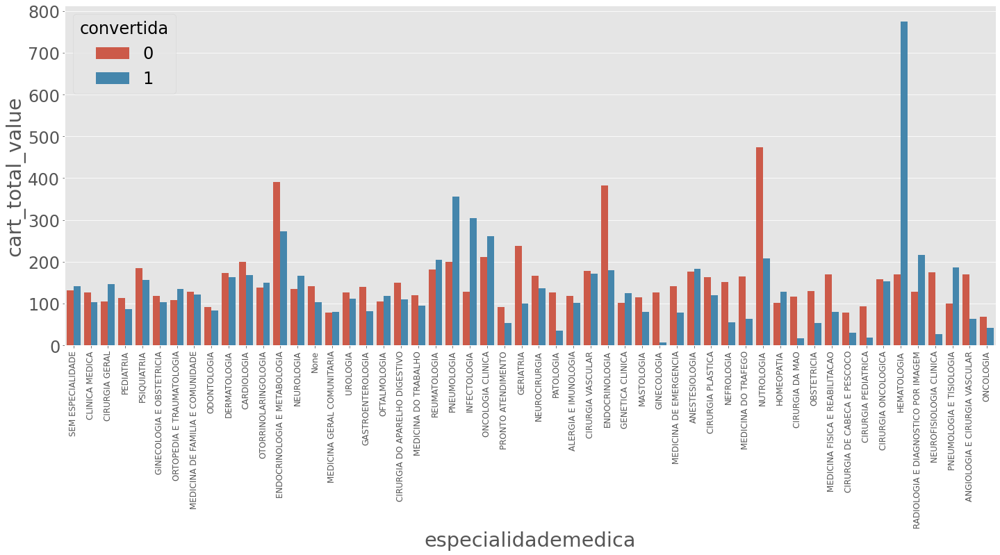

In [0]:
"""
- Com exceção de Hematologia, Pneumologia e Radiologia, o valor do carrinho no fechamento da compra são em geral mais baixo do que o valor médio das compras não convertidas.
- Olhando de forma geral, o valor médio é muito parecido, mas a especialidade diferencia
""" 

df_cart_cv = df2[df2["especialidademedica"].isin(especialidades_conversao)][["especialidademedica", "convertida", "cart_total_value"]].groupby(["especialidademedica", "convertida"]).mean().reset_index()

df2[df2["especialidademedica"].isin(especialidades_conversao)][["convertida", "cart_total_value"]].groupby(["convertida"]).mean().reset_index().display()

sns.barplot(data=df_cart_cv, x="especialidademedica", y="cart_total_value", hue="convertida", order=df_sucesso_order)
plt.xticks(rotation=90, fontsize=12);

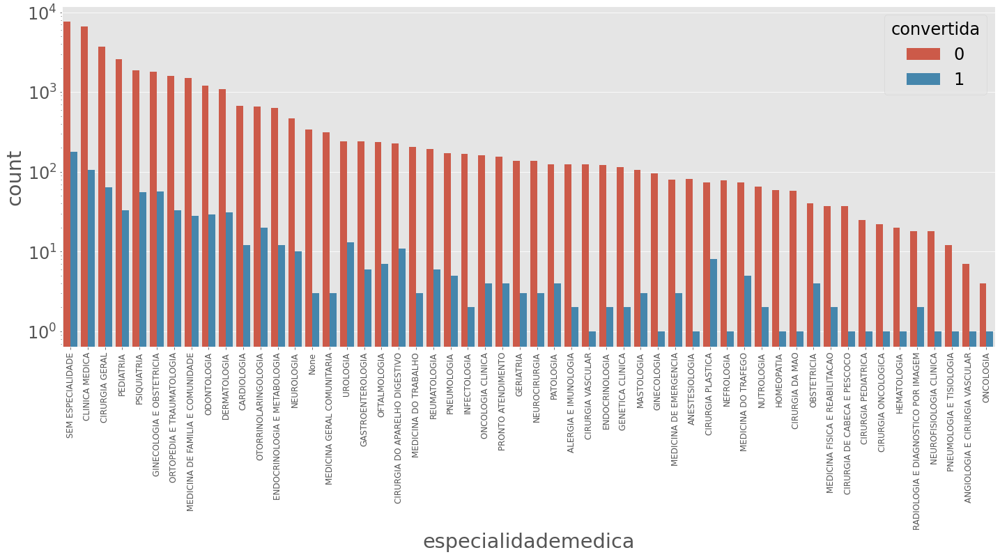

In [0]:
ax_esp = sns.countplot(data= df2[df2["especialidademedica"].isin(especialidades_conversao)], x="especialidademedica", hue="convertida", order=df_sucesso_order)
ax_esp.set_yscale("log")
plt.xticks(rotation=90, fontsize=12);

In [0]:
bins = [0, 50, 100, 300, 500, 700, 1000, 2000, 100000]
labels = ["0-50", "50-100", "100-300", "300-500", "500-700", "700-1000", "1000-2000", "2000+"] 

df_cart_values = df2.copy()
df_cart_values["bin_cart_values"] = pd.cut(df_cart_values["cart_total_value"], bins=bins, labels=labels, right=False)

df_cart_values.groupby("bin_cart_values").agg(
    total_registros = ("convertida", "count"),
    total_sucessos = ("convertida", "sum")
).reset_index().display()

df2 = df_cart_values.copy()

bin_cart_values,total_registros,total_sucessos
0-50,10117,179
50-100,10247,236
100-300,11860,313
300-500,1664,41
500-700,451,12
700-1000,244,8
1000-2000,272,2
2000+,90,0


Out[16]: <AxesSubplot:xlabel='bin_cart_values', ylabel='Count'>

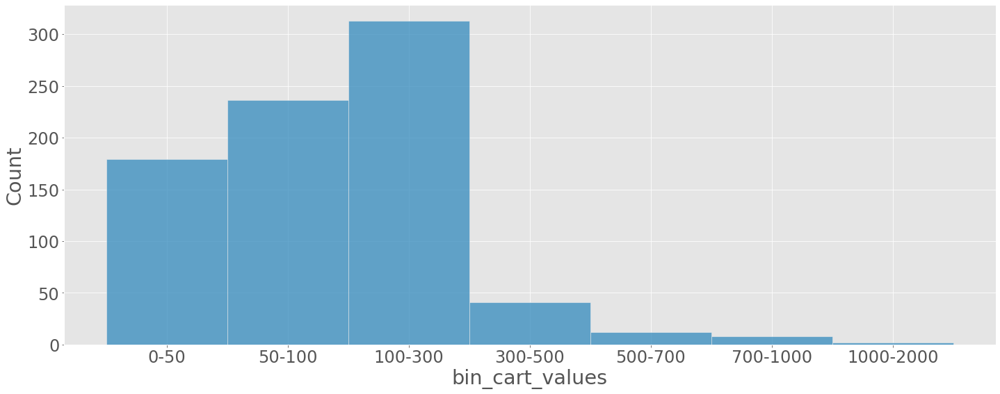

In [0]:
sns.histplot(data=df_cart_values[df_cart_values["convertida"]==1], x="bin_cart_values")

In [0]:
"""
DDD
- Há localidades que nunca ocorreram conversão de vendas.
"""

df_ddd = df2.groupby("ddd").agg(
    total_registros = ("convertida", "count"),
    total_sucessos = ("convertida", "sum")
).reset_index()

df_ddd["percentual"] = df_ddd["total_sucessos"] / df_ddd["total_registros"]

# CAPTURANDO ESPECIALIDADES COM CONVERSÃO
ddd_conversao = sorted(df_ddd[df_ddd['percentual']>0]['ddd'].tolist())

print(f"Total ddd: {len(df_ddd)} \n Total Sucesso: {df_ddd[df_ddd['percentual']>0]['percentual'].count()}")
df_ddd.display()

Total ddd: 68 
 Total Sucesso: 33


ddd,total_registros,total_sucessos,percentual
11,16253,576,0.035439611148711005
12,1075,10,0.009302325581395349
13,272,9,0.03308823529411765
14,175,1,0.005714285714285714
15,323,4,0.01238390092879257
16,521,2,0.003838771593090211
17,363,3,0.008264462809917356
18,149,4,0.026845637583892617
19,881,10,0.011350737797956867
21,1780,15,0.008426966292134831


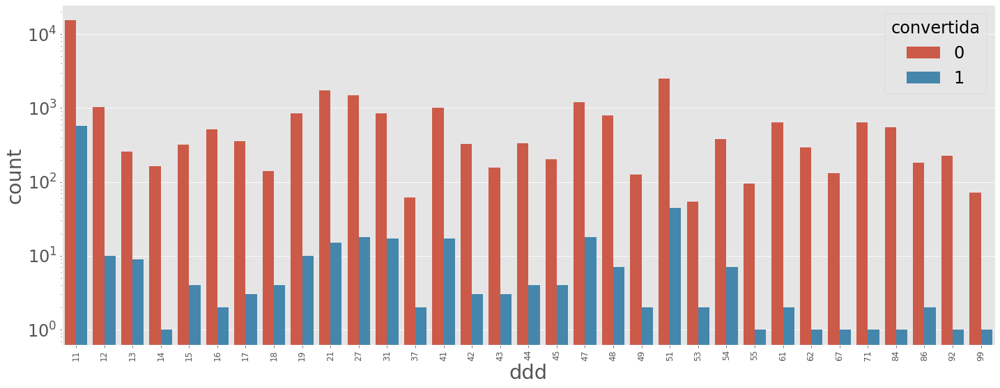

In [0]:
"""
- DDD SP(com 11 principalmente) concentra a maior quantidade de atendimentos e onde ocorre a maior conversão nas vendas.
""" 

ax_ddd = sns.countplot(data=df2[(df2["especialidademedica"].isin(especialidades_conversao)) &
                                (df2["ddd"].isin(ddd_conversao))], x="ddd", hue="convertida", order=ddd_conversao)
ax_ddd.set_yscale("log")
plt.xticks(rotation=90, fontsize=12);

In [0]:
"""
CEP2
- Há localidades que nunca ocorreram conversão de vendas.
"""

df_cep = df2.groupby("cep2").agg(
    total_registros = ("convertida", "count"),
    total_sucessos = ("convertida", "sum")
).reset_index()

df_cep["percentual"] = df_cep["total_sucessos"] / df_cep["total_registros"]

print(f"Total ddd: {len(df_cep)} \n Total Sucesso: {df_cep[df_cep['percentual']>0]['percentual'].count()}")
df_cep.display()

Total ddd: 100 
 Total Sucesso: 48


cep2,total_registros,total_sucessos,percentual
0,135,5,0.037037037037037035
1,937,42,0.044823906083244394
11,313,2,0.006389776357827476
12,1091,13,0.011915673693858845
13,1100,11,0.01
14,455,1,0.002197802197802198
15,312,2,0.00641025641025641
16,36,1,0.027777777777777776
17,51,0,0.0
18,449,4,0.008908685968819599


In [0]:
"""
Poderia ser o inicio do cep, mas aparantemente é final do CEP.
Se fosse 01 seria capital SP, mas ao olhar 1 os DDS correspondem a outras localidades
"""
ddd_cep = df2[["ddd", "cep2"]].drop_duplicates()
ddd_cep.sort_values("ddd").display()

ddd,cep2
11,60
11,73
11,15
11,74
11,88
11,42
11,80
11,84
11,32
11,93


In [0]:
df2.display()

idprescricao,idpaciente,idmedico,idparceiro,dataprescricao,convertida,ddd,idadepaciente,primeira_compra,cart_total_value,especialidademedica,conselhoprofissional,origemprescricao,hora_prescricao,diadasemanaprescricao,usocontinuo,mip,controleespecial,paciente_count_compras_30d,paciente_count_compras_90d,paciente_count_exames_30d,paciente_count_exames_90d,paciente_count_prescricoes_30d,paciente_count_prescricoes_90d,medico_count_assinado_30d,medico_count_compras_30d,medico_count_downloadpdf_30d,medico_count_prescricoes_30d,parceiro_count_assinado_30d,parceiro_count_compras_30d,parceiro_count_downloadpdf_30d,parceiro_count_prescricoes_30d,tem_atestado,tem_exame,cep2,bin_cart_values
84156133,11331887,79367,98,2025-07-30T00:00:00.000+0000,0,27,31,1,128.98,CLINICA MEDICA,CRM,B2B,0,4. quarta,0,1,1,0,0,0,0,1,3,53,0,16,53,69317,1177,31902,69412,1,0,29,100-300
84157621,15451635,74233,309,2025-07-30T00:00:00.000+0000,0,11,41,1,123.35,CLINICA MEDICA,CRM,B2B,1,4. quarta,0,1,0,0,0,0,0,1,1,360,360,48,180,44922,976,5580,48881,0,0,5,100-300
84158114,6792626,92277,331,2025-07-30T00:00:00.000+0000,0,11,35,1,189.96,CLINICA MEDICA,CRM,B2C,1,4. quarta,0,0,0,0,0,0,0,4,4,11,11,0,11,128176,2086,52772,135982,0,0,2,100-300
84159307,15451952,60100,388,2025-07-30T00:00:00.000+0000,0,11,40,1,47.08,SEM ESPECIALIDADE,CRM,B2B,2,4. quarta,0,0,0,0,0,0,0,1,1,502,502,356,502,45423,481,29873,45447,0,0,13,0-50
84160093,15452114,136332,271,2025-07-30T00:00:00.000+0000,0,47,4,1,140.86,PEDIATRIA,CRM,B2B,2,4. quarta,0,1,1,0,0,0,0,1,1,70,0,21,70,18128,274,3803,19436,0,0,88,100-300
84163575,15452782,155105,431,2025-07-30T00:00:00.000+0000,0,85,36,1,null,PSIQUIATRIA,CRM,B2B,10,4. quarta,0,0,1,0,0,0,0,1,1,200,0,100,200,30342,200,18359,30430,0,0,60,null
84163603,7822593,45756,330,2025-07-30T00:00:00.000+0000,0,27,9,1,61.99,PEDIATRIA,CRM,B2B,10,4. quarta,0,1,0,0,0,0,0,1,1,0,1056,8,264,35789,229,9039,71610,0,0,29,50-100
84164883,13055754,144389,331,2025-07-30T00:00:00.000+0000,0,84,42,1,14.79,ODONTOLOGIA,CRO,B2C,10,4. quarta,0,0,0,0,0,0,0,1,5,4,0,2,4,128176,2086,52772,135982,0,0,59,0-50
84166267,11122099,42775,82,2025-07-30T00:00:00.000+0000,0,11,41,1,39.99,CIRURGIA DO APARELHO DIGESTIVO,CRM,B2B,10,4. quarta,0,1,1,0,0,0,0,1,1,40,0,1,40,126457,2591,7827,207994,0,0,3,0-50
84167539,15453431,145178,431,2025-07-30T00:00:00.000+0000,0,11,31,1,28.99,ENDOCRINOLOGIA,CRM,B2B,11,4. quarta,1,0,0,0,0,0,0,1,1,32,0,18,33,30342,200,18359,30430,0,0,8,0-50


In [0]:
df2.groupby("paciente_count_compras_30d").agg(
    total_registros = ("convertida", "count"),
    total_sucessos = ("convertida", "sum")
).reset_index().display()

df2.groupby("paciente_count_compras_90d").agg(
    total_registros = ("convertida", "count"),
    total_sucessos = ("convertida", "sum")
).reset_index().display()

paciente_count_compras_30d,total_registros,total_sucessos
0,36632,22
1,1111,607
2,195,110
3,58,33
4,21,15
5,3,2
6,1,1
7,3,1
8,2,0
9,1,1


paciente_count_compras_90d,total_registros,total_sucessos
0,36632,22
1,1111,607
2,195,110
3,58,33
4,21,15
5,3,2
6,1,1
7,3,1
8,2,0
9,1,1


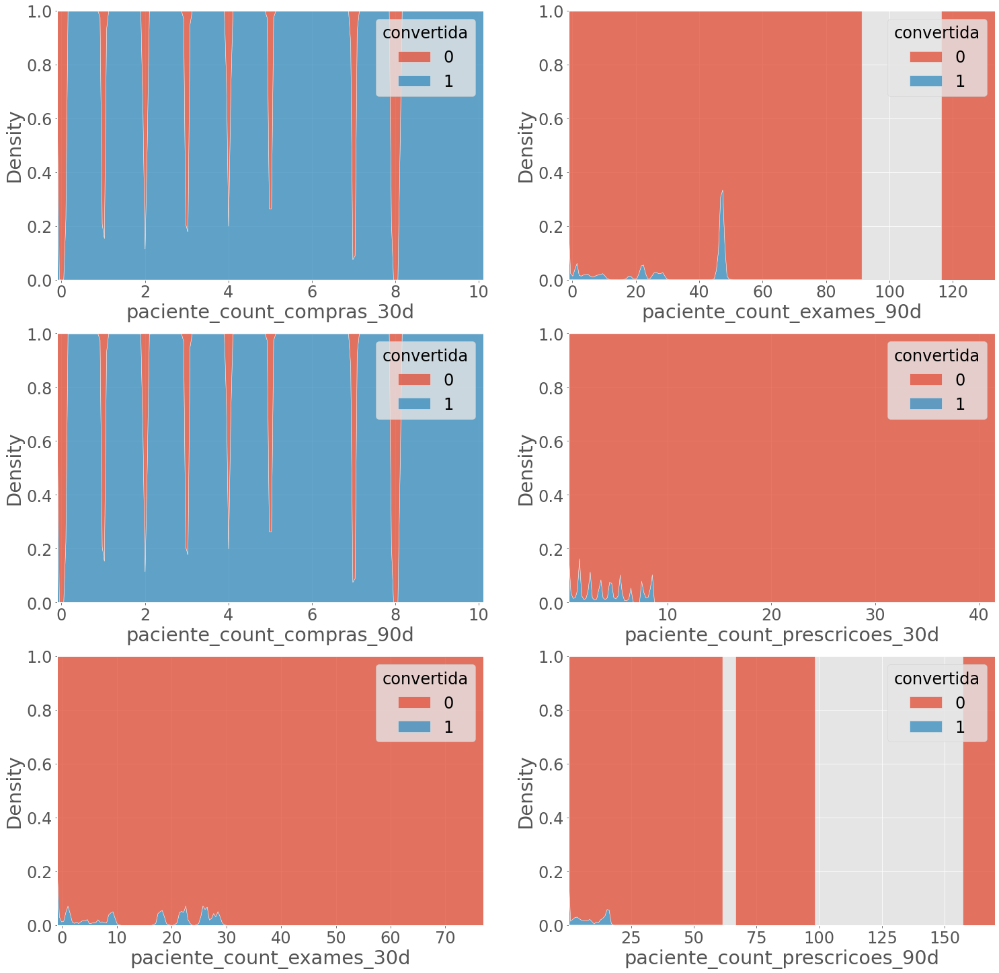

In [0]:
"""
CONTAGE PACIENTE
- paciente_count_compras_30d e paciente_count_compras_90d = na amostra atual representam a mesma informação, ficar apenas com uma delas. Quanto mais o paciente compra, maior a chance de conversão futura.
- paciente_count_exames_30d e paciente_count_exames_90d = simples fato do paciente ter muitos exames, não significa que irá comprar o remédio
- 

"""

count_ft = ['paciente_count_compras_30d','paciente_count_compras_90d', 'paciente_count_exames_30d','paciente_count_exames_90d', 'paciente_count_prescricoes_30d','paciente_count_prescricoes_90d']

fig, axes = plt.subplots(3, 2, figsize=(25,25))
ft_ = 0
for i in range(0, 2):
  for c in range(0, 3):
    sns.kdeplot(ax=axes[c][i], x=count_ft[ft_], data=df2, hue="convertida", multiple="fill")
    ft_ += 1

In [0]:
p_score = df2[["idpaciente", *count_ft]].drop_duplicates().copy()
p_score["score_30"] = (0.6*p_score["paciente_count_compras_30d"] + 0.2*p_score["paciente_count_exames_30d"] + 0.2*p_score["paciente_count_prescricoes_30d"])/(p_score["paciente_count_compras_30d"]+p_score["paciente_count_exames_30d"]+p_score["paciente_count_prescricoes_30d"])
p_score["score_90"] = (0.6*p_score["paciente_count_compras_90d"] + 0.2*p_score["paciente_count_exames_90d"] + 0.2*p_score["paciente_count_prescricoes_90d"])/(p_score["paciente_count_compras_90d"]+p_score["paciente_count_exames_90d"]+p_score["paciente_count_prescricoes_90d"])
p_score["score_avg"] = (p_score["score_30"] + p_score["score_90"])/2
p_score = p_score[["idpaciente", "score_30", "score_90", "score_avg"]].copy()

score_paciente = df2[["idprescricao", "idpaciente", "convertida"]].merge(p_score, on="idpaciente", how="left").copy()
score_paciente.groupby("score_avg").agg(
    total_registros = ("convertida", "count"),
    total_sucessos = ("convertida", "sum")
).reset_index().display()

score_avg,total_registros,total_sucessos
0.19999999999999998,60,0
0.2,34195,22
0.20000000000000004,2377,0
0.20248043347381095,1,0
0.20815993472052224,1,0
0.2089989888776542,1,0
0.2129032258064516,1,0
0.21311827956989246,2,0
0.21333333333333335,1,1
0.21400000000000002,1,1


Out[40]: <AxesSubplot:xlabel='score_avg', ylabel='Density'>

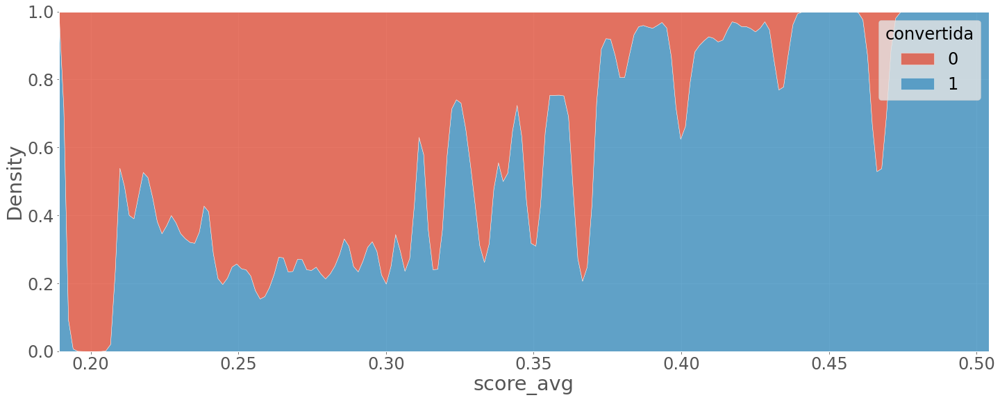

In [0]:
sns.kdeplot(x="score_avg", data=score_paciente, hue="convertida", multiple="fill")

In [0]:
# NESSA BASE NÃO EXISTE DIFERENÇA NO RETORNO DO PACIENTE ENTRE 30 E 90 DIAS
p_score_2 = df2[["idpaciente", *count_ft]].drop_duplicates().copy()
p_score_2["diff_3090"] = p_score_2["paciente_count_compras_90d"] - p_score_2["paciente_count_compras_30d"]
p_score_2[p_score_2["diff_3090"]>0].count()

Out[26]: idpaciente                        0
paciente_count_compras_30d        0
paciente_count_compras_90d        0
paciente_count_exames_30d         0
paciente_count_exames_90d         0
paciente_count_prescricoes_30d    0
paciente_count_prescricoes_90d    0
diff_3090                         0
dtype: int64

In [0]:
# MATRIX RFV
# R = 5 (mais recente) até 1 (menos recente)
# F = 1 (poucas compras) até 5 (muitas compras)
# V = 1 (baixo gasto) até 5 (alto gasto)

In [0]:
df_rfv = df2[["idpaciente", "dataprescricao", "convertida", "cart_total_value", "paciente_count_compras_30d"]].copy()

In [0]:
def rfv_recency(x):
  if x<=1:
    result = 1
  elif (x>1) & (x<=7):
    result = 2
  elif (x>7) & (x<=15):
    result = 3
  elif (x>15) & (x<=30):
    result = 4
  else:
    result = 5
  return result

def rfv_frequency(x):
  if x<=1:
    result = 1
  elif (x>1) & (x<=3):
    result = 2
  elif (x>3) & (x<=5):
    result = 3
  elif (x>5) & (x<=10):
    result = 4
  else:
    result = 5
  return result

In [0]:
rfv = df_rfv[df_rfv["convertida"]==1].groupby("idpaciente").agg({
    "dataprescricao": lambda x: (pd.to_datetime("2025-08-10") - x.max()).days,  # Recência
    "paciente_count_compras_30d": "max",  # Frequência
    "cart_total_value": "sum"  # Valor monetário
}).rename(columns={"dataprescricao":"Recencia","paciente_count_compras_30d":"Frequencia","cart_total_value":"Valor"}).reset_index()

rfv["R_score"] = rfv["Recencia"].apply(lambda x: rfv_recency(x))
rfv["F_score"] = rfv["Frequencia"].apply(lambda x: rfv_frequency(x))
rfv["V_score"] = pd.qcut(rfv["Valor"], 5, labels=[1,2,3,4,5])

def segmentar(r, f, v):
    if ((v >= 4) | (f >= 4)) and (r <= 2):
        return "Não Perder"
    elif ((v >= 4) | (f >= 4)) and ((r >= 3) & (r <= 4)):
        return "Fieis"
    elif ((v >= 4) | (f >= 4)) and (r > 4):
        return "Campeão"
    elif ((v >= 2) & (v <= 4) | (f >= 2) & (f <= 4)) and (r <= 2):
        return "Em risco"
    elif ((v >= 2) & (v <= 4) | (f >= 2) & (f <= 4)) and ((r >= 3) & (r <= 4)):
        return "Atenção"
    elif ((v >= 2) & (v <= 4) | (f >= 2) & (f <= 4)) and (r > 4):
        return "Potencial fiel"
    elif ((v <= 2) | (f <= 2)) and (r <= 2):
        return "Perdidos"
    elif ((v <= 2) | (f <= 2)) and ((r >= 3) & (r <= 4)):
        return "Quase Inativo"
    elif ((v <= 2) | (f <= 2)) and (r > 4):
        return "Novos"

rfv["Segmento"] = rfv.apply(lambda x: segmentar(int(x.R_score), int(x.F_score), int(x.V_score)), axis=1)

In [0]:
rfv_s = df_rfv[df_rfv["convertida"]==0].groupby("idpaciente").agg({
    "paciente_count_compras_30d": "max",  # Frequência
}).rename(columns={"paciente_count_compras_30d":"Frequencia"}).reset_index()
rfv_s["Recencia"] = 30
rfv_s["Valor"] = 0

rfv_s["R_score"] = 1
rfv_s["F_score"] = rfv_s["Frequencia"].apply(lambda x: rfv_frequency(x))
rfv_s["V_score"] = 1

rfv_s["Segmento"] = rfv_s.apply(lambda x: segmentar(int(x.R_score), int(x.F_score), int(x.V_score)), axis=1)

In [0]:
rfv_g = pd.concat([rfv, rfv_s], axis=0)
rfv_g.groupby("Segmento").agg({"idpaciente": "count"}).reset_index().sort_values("idpaciente", ascending=False).display()

Segmento,idpaciente
Perdidos,36440
Em risco,321
Não Perder,204
Atenção,125
Fieis,115
Quase Inativo,52


Databricks visualization. Run in Databricks to view.

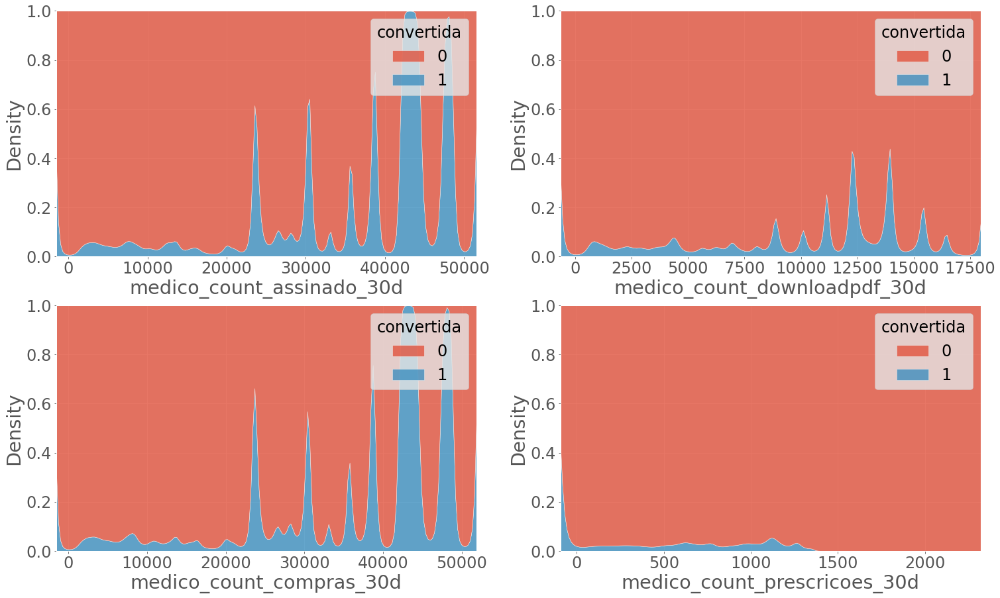

In [0]:
count_ft_med = ['medico_count_assinado_30d','medico_count_compras_30d', 'medico_count_downloadpdf_30d','medico_count_prescricoes_30d']

fig, axes = plt.subplots(2, 2, figsize=(25,15))
ft_ = 0
for i in range(0, 2):
  for c in range(0, 2):
    sns.kdeplot(ax=axes[c][i], x=count_ft_med[ft_], data=df2, hue="convertida", multiple="fill")
    ft_ += 1

In [0]:
m_score = df2[["idmedico", *count_ft_med]].drop_duplicates().copy()
m_score["score_avg"] = (0.4*m_score["medico_count_assinado_30d"] + 0.2*m_score["medico_count_downloadpdf_30d"] + 0.2*m_score["medico_count_downloadpdf_30d"]+ 0.2*m_score["medico_count_prescricoes_30d"])/(m_score["medico_count_assinado_30d"]+m_score["medico_count_downloadpdf_30d"]+m_score["medico_count_downloadpdf_30d"]+m_score["medico_count_prescricoes_30d"])
m_score = m_score[["idmedico", "score_avg"]].copy()

score_medico = df2[["idprescricao", "idmedico", "convertida"]].merge(m_score, on="idmedico", how="left").copy()
score_medico.groupby("score_avg").agg(
    total_registros = ("convertida", "count"),
    total_sucessos = ("convertida", "sum")
).reset_index().display()

score_avg,total_registros,total_sucessos
0.19999999999999998,234,1
0.2,1833,31
0.20000000000000004,345,11
0.20024968789013733,3,0
0.2005434782608696,2,0
0.2010443864229765,4,0
0.20126582278481014,1,0
0.2013071895424837,1,0
0.20134228187919465,2,1
0.20141843971631207,2,0


Out[29]: <AxesSubplot:xlabel='score_avg', ylabel='Density'>

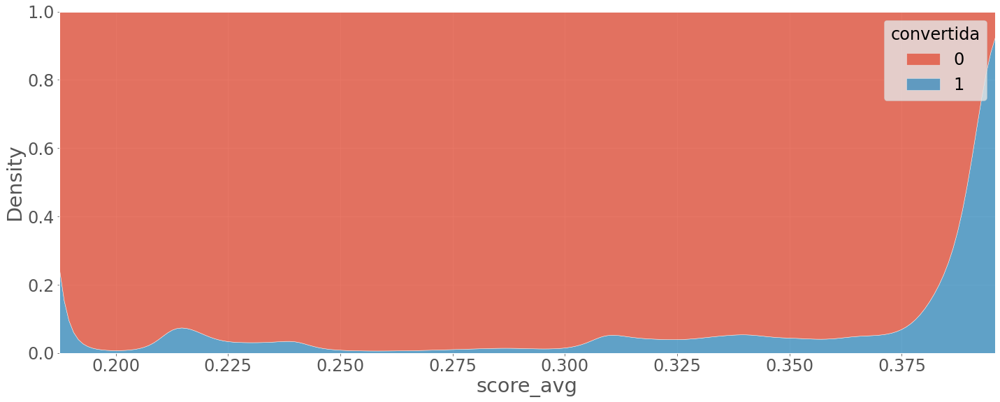

In [0]:
sns.kdeplot(x="score_avg", data=score_medico, hue="convertida", multiple="fill")

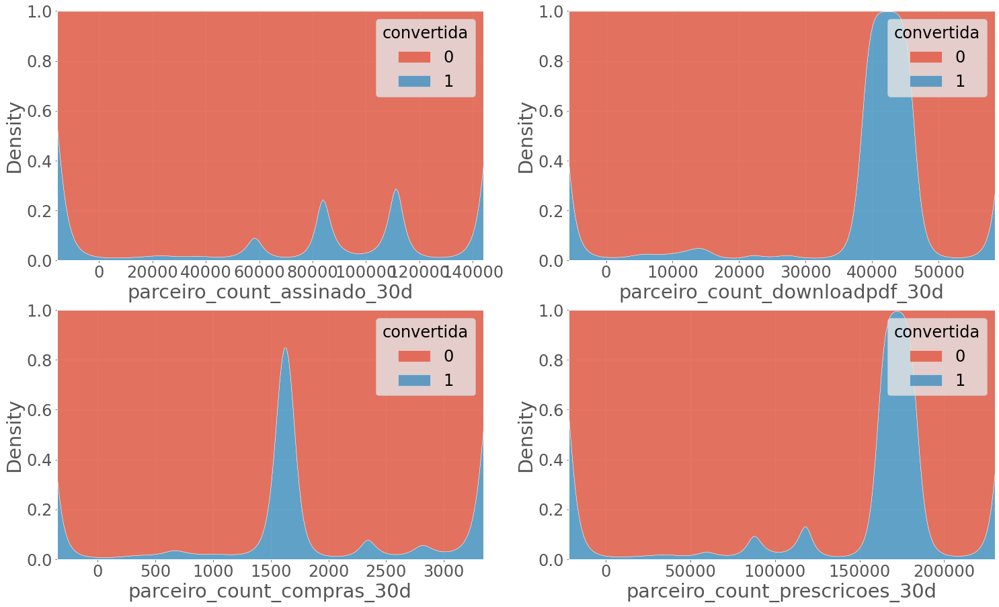

In [0]:
count_ft_par = ['parceiro_count_assinado_30d','parceiro_count_compras_30d', 'parceiro_count_downloadpdf_30d','parceiro_count_prescricoes_30d']

fig, axes = plt.subplots(2, 2, figsize=(25,15))
ft_ = 0
for i in range(0, 2):
  for c in range(0, 2):
    sns.kdeplot(ax=axes[c][i], x=count_ft_par[ft_], data=df2, hue="convertida", multiple="fill")
    ft_ += 1

In [0]:
pt_score = df2[["idparceiro", *count_ft_par]].drop_duplicates().copy()
pt_score["score_avg"] = (0.2*pt_score["parceiro_count_assinado_30d"] + 0.2*pt_score["parceiro_count_compras_30d"] + 0.3*pt_score["parceiro_count_downloadpdf_30d"]+ 0.3*pt_score["parceiro_count_prescricoes_30d"])/(pt_score["parceiro_count_assinado_30d"]+pt_score["parceiro_count_compras_30d"]+pt_score["parceiro_count_downloadpdf_30d"]+pt_score["parceiro_count_prescricoes_30d"])
pt_score = pt_score[["idparceiro", "score_avg"]].copy()

score_partner = df2[["idprescricao", "idparceiro", "convertida"]].merge(pt_score, on="idparceiro", how="left").copy()
score_partner.groupby("score_avg").agg(
    total_registros = ("convertida", "count"),
    total_sucessos = ("convertida", "sum")
).reset_index().display()

score_avg,total_registros,total_sucessos
0.2496402877697842,2,0
0.25,1,0
0.25060240963855424,3,0
0.25076335877862593,4,0
0.251004582305252,40,0
0.25102568522668506,91,1
0.2512280422859868,174,1
0.25128859561752986,117,0
0.2515463917525773,17,0
0.25181347150259065,2,0


Out[32]: <AxesSubplot:xlabel='score_avg', ylabel='Density'>

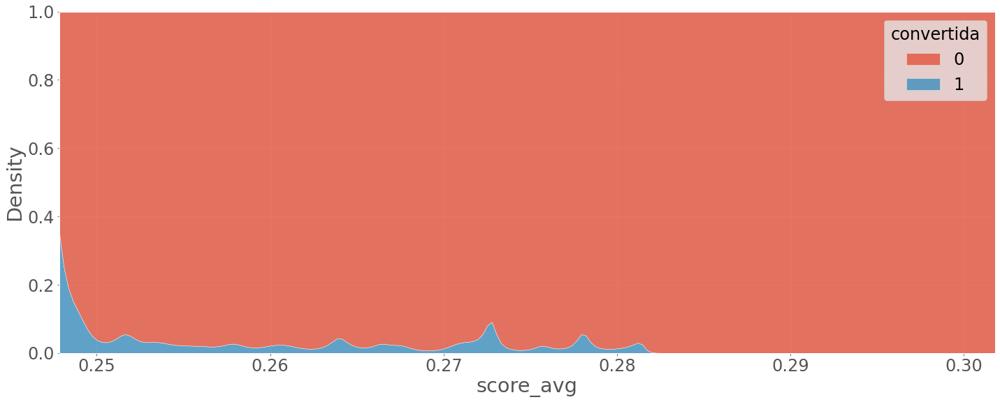

In [0]:
sns.kdeplot(x="score_avg", data=score_partner, hue="convertida", multiple="fill")

In [0]:
st_presc = df2.groupby(["diadasemanaprescricao", "hora_prescricao"]).agg(
    total_registros = ("convertida", "count"),
    total_sucessos = ("convertida", "sum")
).reset_index().sort_values(["diadasemanaprescricao", "hora_prescricao"])

st_presc["aderencia"] = st_presc["total_sucessos"] / st_presc["total_registros"]

In [0]:
"""
Durante a semana é o período em que há mais conversões de compra. Sabado é quase a metade e Domingo é pior momento.
"""

df2.groupby(["diadasemanaprescricao"]).agg(
    total_registros = ("convertida", "count"),
    total_sucessos = ("convertida", "sum")
).reset_index().sort_values(["diadasemanaprescricao"]).display()

diadasemanaprescricao,total_registros,total_sucessos
1. domingo,2405,31
2. segunda,5852,156
3. terça,4689,101
4. quarta,7117,148
5. quinta,7285,154
6. sexta,7190,138
7. sabado,3491,66


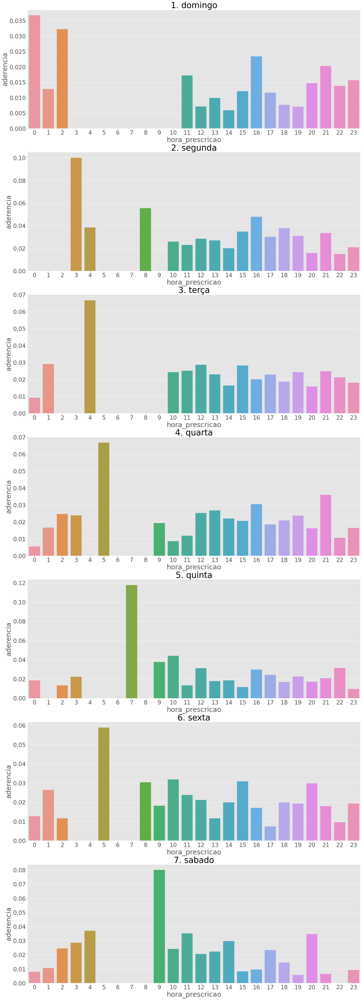

In [0]:
"""
Grande parte das compras acontece durante o dia. Porém a conversão a noite podem ser mais altas devido a urgência quando ocorre atendimento.
Período entre as 9 até as 15 possuem maior propensão de compra
"""

fig, axes = plt.subplots(7, 1, figsize=(25,75))

dia_semana = st_presc["diadasemanaprescricao"].unique().tolist()
ft_ = 0
for i in range(0, 7):
  sns.barplot(ax=axes[i],data=st_presc[st_presc["diadasemanaprescricao"]==dia_semana[i]], x="hora_prescricao", y="aderencia")
  axes[i].set_title(dia_semana[i])

In [0]:
"""
Confirmando a suspeita anterior, quanto mais sentido para o almoço maior a conversão e vai decaindo até o fim do dia.
"""

bins = [0, 3, 6, 9, 12, 15, 18, 21, 24]
labels = ["0-3", "3-6", "6-9", "9-12", "12-15", "15-18", "18-21", "21-24"] 

df_hor_bin = df2.copy()
df_hor_bin["bin_hora_prescricao"] = pd.cut(df_hor_bin["hora_prescricao"], bins=bins, labels=labels, right=False)

df_hor_bin.groupby("bin_hora_prescricao").agg(
    total_registros = ("convertida", "count"),
    total_sucessos = ("convertida", "sum")
).reset_index().display()

bin_hora_prescricao,total_registros,total_sucessos
0-3,2039,29
3-6,528,10
6-9,337,4
9-12,4046,87
12-15,11103,243
15-18,7977,179
18-21,7699,159
21-24,4300,83


In [0]:
"""
Produtos sem usocontinuo são aqueles com maior conversão, e importante destacar que não são mip possuem maior conversão.
Quando há uso continuo, provavelmente as pessoas devem pesquisar mais ou já possuem noção do preço do medicamento e abandonam a compra quando percebem que o item não está dentro do esperado...
"""

df2.groupby(["usocontinuo", "mip", "controleespecial"]).agg(
    total_registros = ("convertida", "count"),
    total_sucessos = ("convertida", "sum")
).reset_index().display()

usocontinuo,mip,controleespecial,total_registros,total_sucessos
0,0,0,6362,123
0,0,1,8527,254
0,1,0,5916,100
0,1,1,11370,186
1,0,0,2523,52
1,0,1,1737,45
1,1,0,953,21
1,1,1,641,13


In [0]:
df2.display()

idprescricao,idpaciente,idmedico,idparceiro,dataprescricao,convertida,ddd,idadepaciente,primeira_compra,cart_total_value,especialidademedica,conselhoprofissional,origemprescricao,hora_prescricao,diadasemanaprescricao,usocontinuo,mip,controleespecial,paciente_count_compras_30d,paciente_count_compras_90d,paciente_count_exames_30d,paciente_count_exames_90d,paciente_count_prescricoes_30d,paciente_count_prescricoes_90d,medico_count_assinado_30d,medico_count_compras_30d,medico_count_downloadpdf_30d,medico_count_prescricoes_30d,parceiro_count_assinado_30d,parceiro_count_compras_30d,parceiro_count_downloadpdf_30d,parceiro_count_prescricoes_30d,tem_atestado,tem_exame,cep2,bin_cart_values
84156133,11331887,79367,98,2025-07-30T00:00:00.000+0000,0,27,31,1,128.98,CLINICA MEDICA,CRM,B2B,0,4. quarta,0,1,1,0,0,0,0,1,3,53,0,16,53,69317,1177,31902,69412,1,0,29,100-300
84157621,15451635,74233,309,2025-07-30T00:00:00.000+0000,0,11,41,1,123.35,CLINICA MEDICA,CRM,B2B,1,4. quarta,0,1,0,0,0,0,0,1,1,360,360,48,180,44922,976,5580,48881,0,0,5,100-300
84158114,6792626,92277,331,2025-07-30T00:00:00.000+0000,0,11,35,1,189.96,CLINICA MEDICA,CRM,B2C,1,4. quarta,0,0,0,0,0,0,0,4,4,11,11,0,11,128176,2086,52772,135982,0,0,2,100-300
84159307,15451952,60100,388,2025-07-30T00:00:00.000+0000,0,11,40,1,47.08,SEM ESPECIALIDADE,CRM,B2B,2,4. quarta,0,0,0,0,0,0,0,1,1,502,502,356,502,45423,481,29873,45447,0,0,13,0-50
84160093,15452114,136332,271,2025-07-30T00:00:00.000+0000,0,47,4,1,140.86,PEDIATRIA,CRM,B2B,2,4. quarta,0,1,1,0,0,0,0,1,1,70,0,21,70,18128,274,3803,19436,0,0,88,100-300
84163575,15452782,155105,431,2025-07-30T00:00:00.000+0000,0,85,36,1,null,PSIQUIATRIA,CRM,B2B,10,4. quarta,0,0,1,0,0,0,0,1,1,200,0,100,200,30342,200,18359,30430,0,0,60,null
84163603,7822593,45756,330,2025-07-30T00:00:00.000+0000,0,27,9,1,61.99,PEDIATRIA,CRM,B2B,10,4. quarta,0,1,0,0,0,0,0,1,1,0,1056,8,264,35789,229,9039,71610,0,0,29,50-100
84164883,13055754,144389,331,2025-07-30T00:00:00.000+0000,0,84,42,1,14.79,ODONTOLOGIA,CRO,B2C,10,4. quarta,0,0,0,0,0,0,0,1,5,4,0,2,4,128176,2086,52772,135982,0,0,59,0-50
84166267,11122099,42775,82,2025-07-30T00:00:00.000+0000,0,11,41,1,39.99,CIRURGIA DO APARELHO DIGESTIVO,CRM,B2B,10,4. quarta,0,1,1,0,0,0,0,1,1,40,0,1,40,126457,2591,7827,207994,0,0,3,0-50
84167539,15453431,145178,431,2025-07-30T00:00:00.000+0000,0,11,31,1,28.99,ENDOCRINOLOGIA,CRM,B2B,11,4. quarta,1,0,0,0,0,0,0,1,1,32,0,18,33,30342,200,18359,30430,0,0,8,0-50
